<a href="https://colab.research.google.com/github/mariaauslander/capstone_fall20_irrigation/blob/master/ca_data_qa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Notebook for Quality Assurance of Level2A California Data from Sentinel-2
## Fall 2020 Capstone
### TP Goter

This is a modified version of the notebook found on GitHub which was used to assess the original California data gathered (which was level 1c or top of atmosphere reflectance). That notebook worked locally. This notebook processes data that lives on the shared Google Drive area and is meant to be run from a Colab environment.

In [2]:
import tarfile
import os
import numpy as np
import PIL
import gdal
import folium
from matplotlib import pyplot as plt
import cv2
import pandas as pd
%matplotlib inline
from google.colab import files
from google.colab import drive

## Mount Google Drive

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Set paths to TIF Files

SR Path is a path to a Google Drive location containing all of the Surface Relectance data for California. There is a folder for each lat,lon processed. Each of these lat,lon regions corresponds to a tiff file that covers ~600 square kilometers of land area and about 9.5M pixels. These larger images will need to be pre-processed, tiling each image down to 120x120 at 10 m resolution for consistency with the Big Earth Net data. That means each of the TIF files in the folders at the 'sr_path' will be tiled into 644 sub-images that will all correspond to the same month. Each larger tile had its month randomly sampled for 2019. So in total our dataset is roughly 644*len(big_regions). However, it should be noted we are looking for tiles with <1% cloud coverage. This means some data is unusable and will be filtered out during the pre-processing.

In [4]:
base_path = '/content/gdrive/My Drive/Capstone Project'
sr_path = os.path.join(base_path, "Sentinel_CA/Level2A")
#
big_regions = os.listdir(sr_path)
os.listdir(sr_path)

['S2SR_5_2019_35.125_-119.875',
 'S2SR_1_2019_35.625_-119.375',
 'S2SR_5_2019_35.625_-119.875',
 'S2SR_1_2019_35.625_-119.625',
 'S2SR_6_2019_35.875_-119.625',
 'S2SR_7_2019_35.625_-119.125',
 'S2SR_8_2019_35.875_-119.125',
 'S2SR_11_2019_35.375_-119.125',
 'S2SR_11_2019_35.375_-119.375',
 'S2SR_11_2019_35.375_-119.625',
 'S2SR_11_2019_35.875_-119.875',
 'S2SR_3_2019_36.125_-119.875',
 'S2SR_12_2019_35.375_-119.875',
 'S2SR_11_2019_36.125_-119.625',
 'S2SR_3_2019_36.125_-119.375',
 'S2SR_2_2019_36.625_-119.375',
 'S2SR_5_2019_36.375_-119.125',
 'S2SR_5_2019_36.875_-119.625',
 'S2SR_6_2019_36.375_-119.625',
 'S2SR_6_2019_36.375_-119.875',
 'S2SR_6_2019_36.875_-119.375',
 'S2SR_8_2019_36.625_-119.125',
 'S2SR_10_2019_36.375_-119.375',
 'S2SR_10_2019_36.625_-119.625',
 'S2SR_11_2019_36.625_-119.875',
 'S2SR_9_2019_36.125_-119.125',
 'S2SR_9_2019_35.125_-119.625',
 'S2SR_10_2019_35.125_-119.375',
 'S2SR_3_2019_35.125_-119.125',
 'S2SR_4_2019_37.375_-120.375',
 'S2SR_5_2019_37.125_-120.375'

## Creat RGB and Agricultural Band Combos for Visualiation

We are going to look at every swath of satellite imagery we generated to determined how many regions are unusable. So we will create image strips for each latitude (and all longitudes for that latitude).

In [5]:
# Spectral band names to read related GeoTIFF files
band_names = ['B2', 'B3', 'B4', 'B5', 'B6',
              'B7', 'B8', 'B8A', 'B11', 'B12']

rgb_names = ['B4', 'B3', 'B2']
ag_names = ['B11', 'B8', 'B2']
band_combinations = [rgb_names, ag_names]

SCALE_FACTOR = 5000

def plot_band_combs(base_paths, band_combinations, scale = SCALE_FACTOR):
  '''
  This function is used to visualize a set of images at a fixed latitude 
  and varying longitudes. he function can take multiple band combinations
  which will be plotted as separate rows.
  '''
  imarrays = []
  for comb in band_combinations:
    for base_path in base_paths:
      for b, band_name in enumerate(comb):
        #print(base_path)
        # First finds related GeoTIFF path and reads values as an array
        band_path = os.path.join(sr_path, base_path, f'{base_path}_msi_{band_name}.tif')
        band_ds = gdal.Open(band_path,  gdal.GA_ReadOnly)
        raster_band = band_ds.GetRasterBand(1)
        band_data = raster_band.ReadAsArray()
        #print(band_data.shape)
        if b == 0:
            imarray = np.zeros((3404, 2784,3))
        if band_data.shape != imarray.shape[:2]:
            band_data = cv2.resize(band_data, (imarray.shape[1],imarray.shape[0]))
        imarray[:,:,b] = band_data / scale

      imarrays.append(imarray)

  fix, axes = plt.subplots(ncols=len(base_paths),
                            nrows=len(band_combinations),
                            sharex=True,
                            sharey=True,
                            figsize=(4*len(base_paths),6*len(band_combinations)))
  axes = axes.flatten()
  for i, img in enumerate(imarrays):
    axes[i].imshow(img)
  for ax in axes:
    ax.set_axis_off()
        
  plt.subplots_adjust(hspace=0.0,wspace=0.0)

## Latitude: 32.625

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


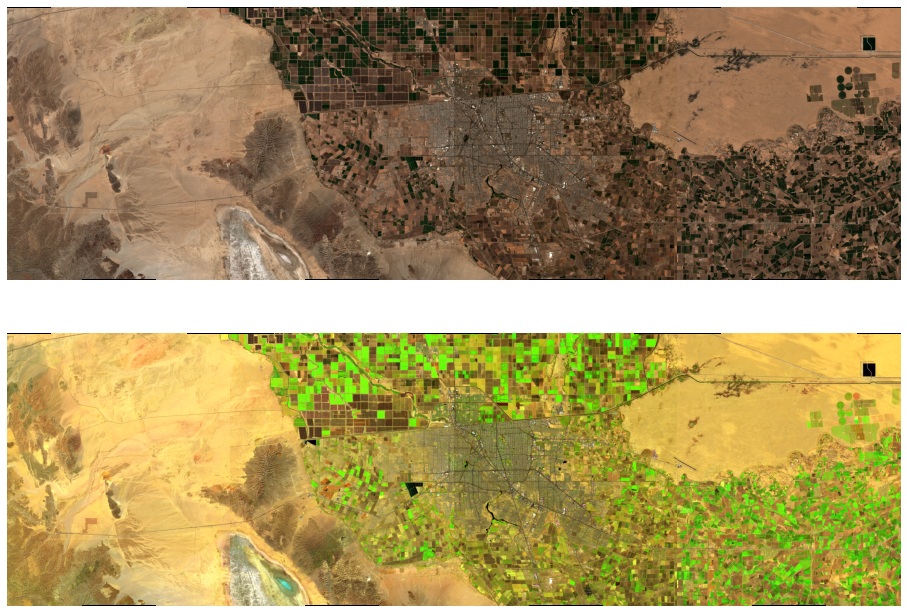

In [7]:
# Set the directories to read from
base_paths = ['S2SR_4_2019_32.625_-115.875',
              'S2SR_10_2019_32.625_-115.625',
              'S2SR_11_2019_32.625_-115.375',
              'S2SR_4_2019_32.625_-115.125']

# Call the plot function
plot_band_combs(base_paths, band_combinations)

## Latitude: 32.875

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


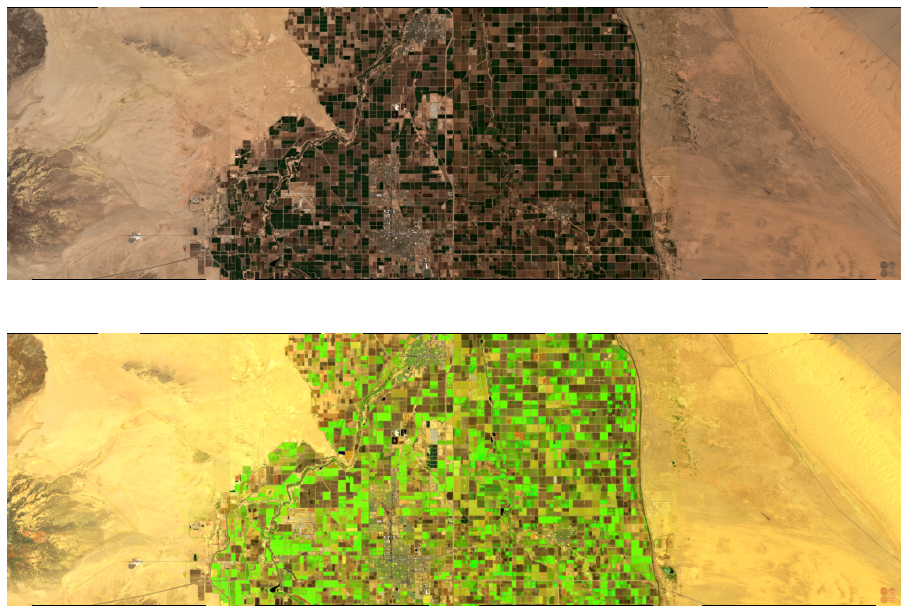

In [13]:
# Set the directories to read from
base_paths = ['S2SR_4_2019_32.875_-115.875',
              'S2SR_10_2019_32.875_-115.625',
              'S2SR_11_2019_32.875_-115.375',
              'S2SR_4_2019_32.875_-115.125']

# Call the plot function
plot_band_combs(base_paths, band_combinations)

## Latitude: 33.125

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


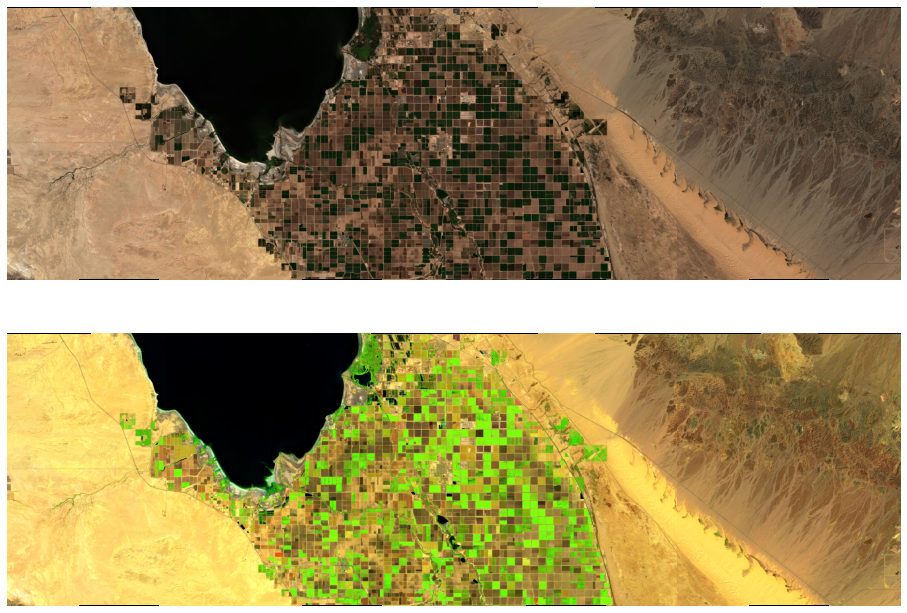

In [14]:
# Set the directories to read from
base_paths = ['S2SR_10_2019_33.125_-115.875',
              'S2SR_10_2019_33.125_-115.625',
              'S2SR_10_2019_33.125_-115.375',
              'S2SR_3_2019_33.125_-115.125']

# Call the plot function
plot_band_combs(base_paths, band_combinations)

## Latitude: 35.125

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


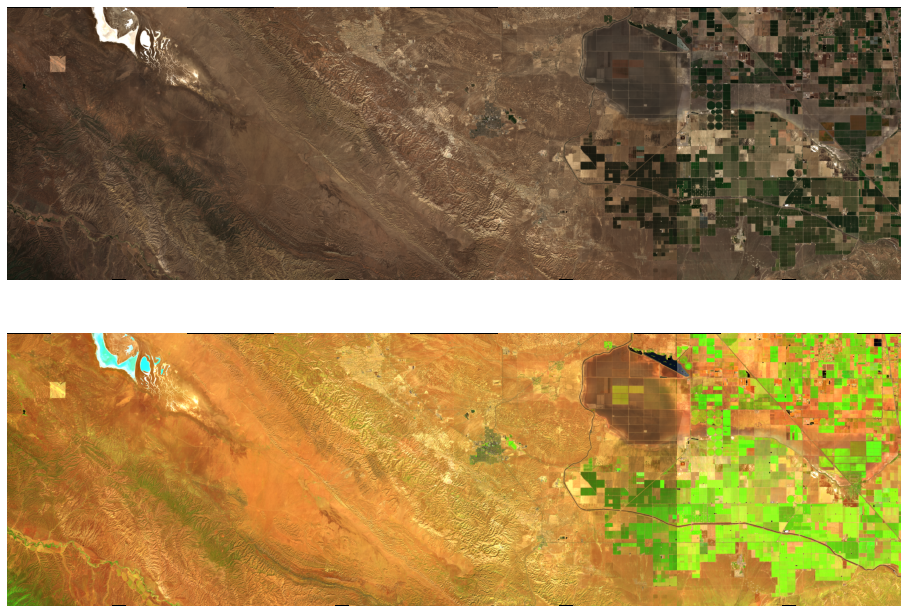

In [ ]:
# Set the directories to read from
base_paths = ['S2SR_8_2019_35.125_-119.875',
              'S2SR_9_2019_35.125_-119.625',
              'S2SR_10_2019_35.125_-119.375',
              'S2SR_6_2019_35.125_-119.125']

# Call the plot function
plot_band_combs(base_paths, band_combinations)

## Latitude: 35.375

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


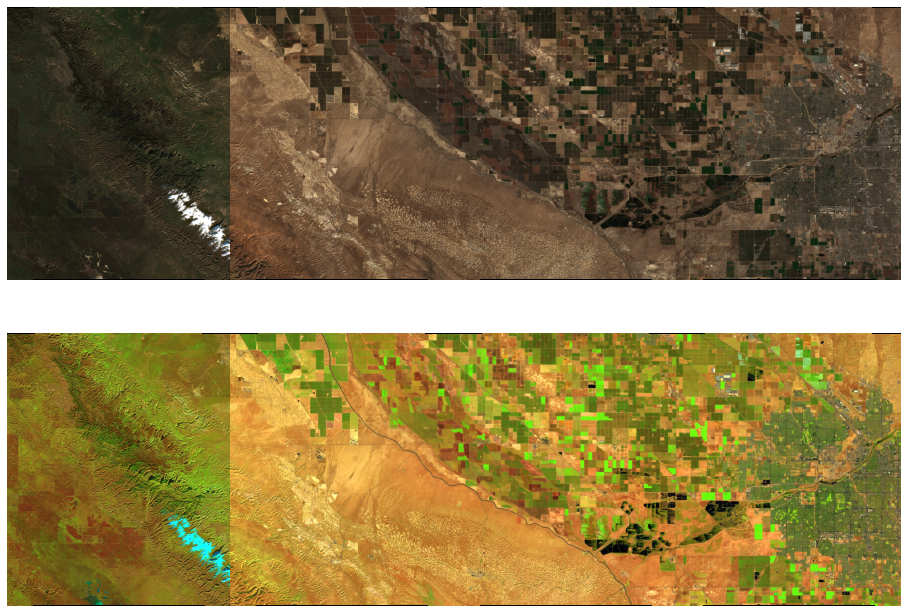

In [ ]:
# Set the directories to read from
base_paths = ['S2SR_12_2019_35.375_-119.875',
              'S2SR_11_2019_35.375_-119.625',
              'S2SR_11_2019_35.375_-119.375',
              'S2SR_11_2019_35.375_-119.125']

# Call the plot function
plot_band_combs(base_paths, band_combinations)

## Latitude: 35.625

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


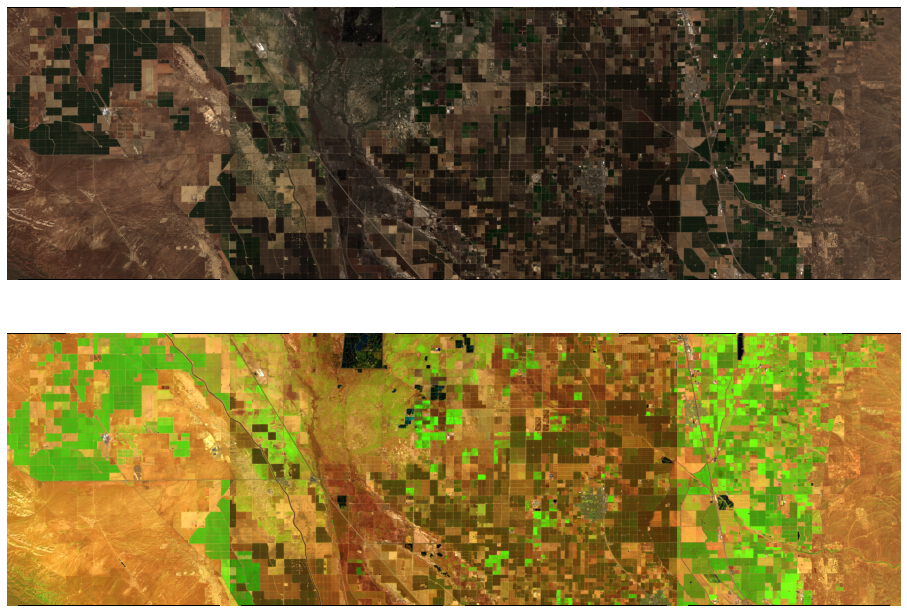

In [ ]:
base_paths = ['S2SR_5_2019_35.625_-119.875',
              'S2SR_1_2019_35.625_-119.625',
              'S2SR_1_2019_35.625_-119.375',
              'S2SR_7_2019_35.625_-119.125']
plot_band_combs(base_paths, band_combinations)

## Latitude: 35.875

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


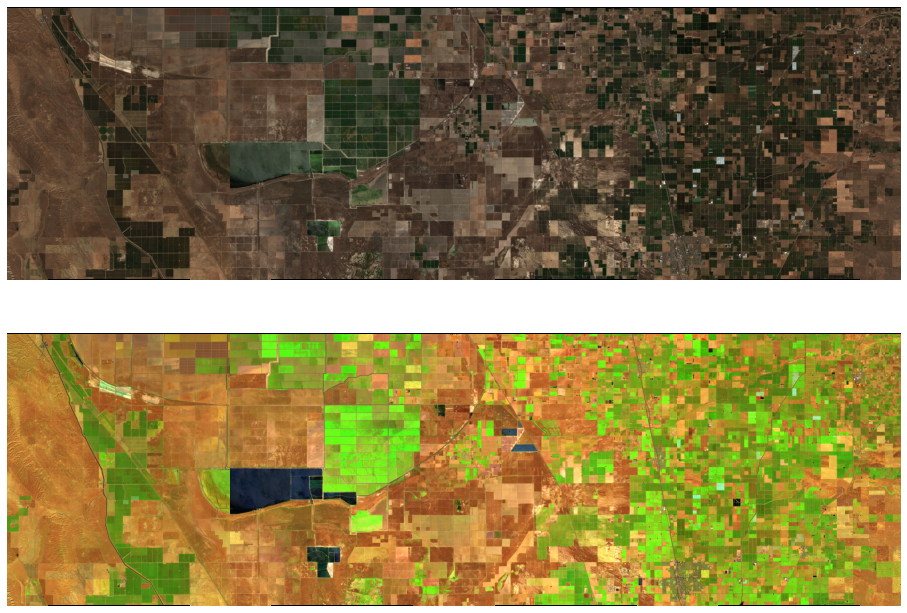

In [ ]:
base_paths = ['S2SR_11_2019_35.875_-119.875',
              'S2SR_6_2019_35.875_-119.625',
              'S2SR_6_2019_35.875_-119.375',
              'S2SR_8_2019_35.875_-119.125']
plot_band_combs(base_paths, band_combinations)

## Latitude: 36.125

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


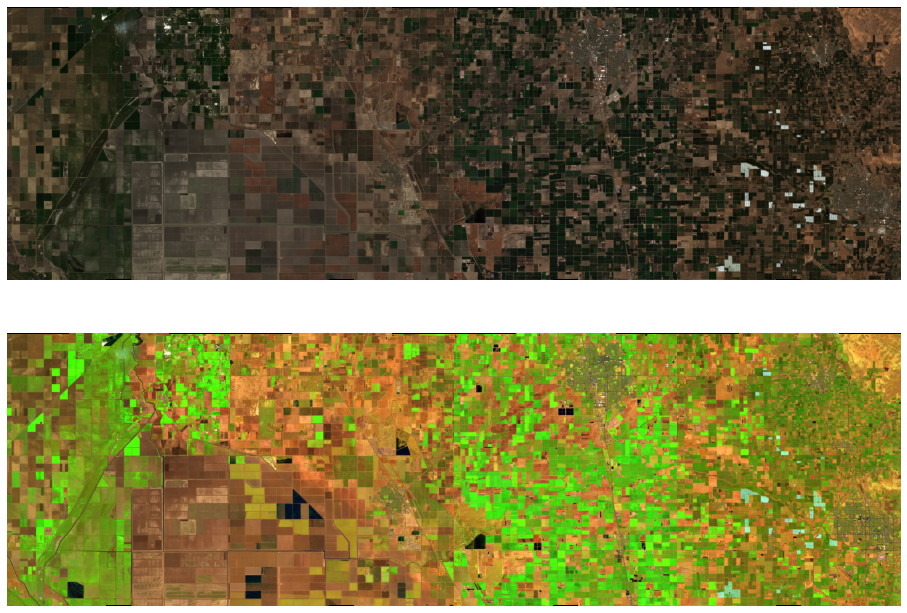

In [ ]:
base_paths = ['S2SR_3_2019_36.125_-119.875',
              'S2SR_11_2019_36.125_-119.625',
              'S2SR_4_2019_36.125_-119.375',
              'S2SR_9_2019_36.125_-119.125']
plot_band_combs(base_paths, band_combinations)

## Latitude: 36.375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


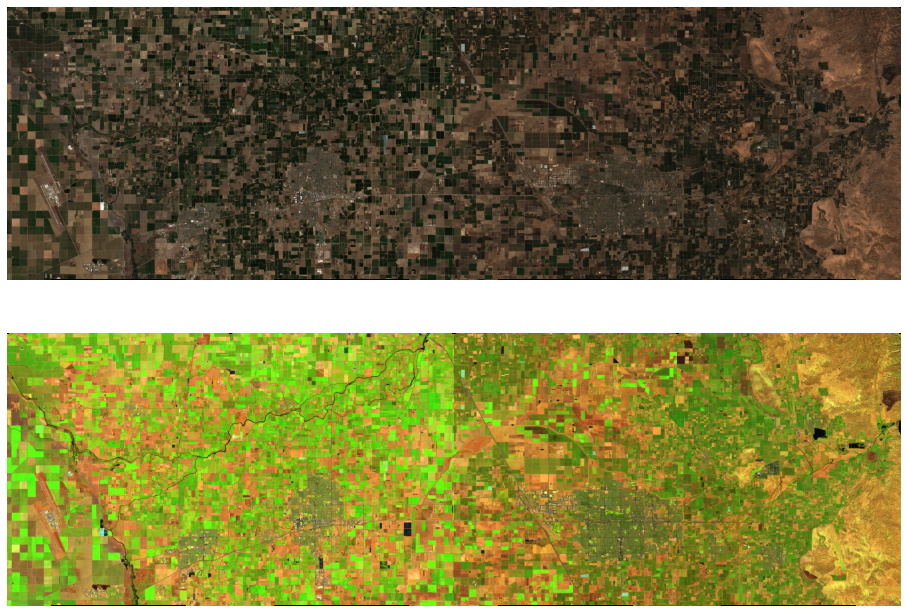

In [ ]:
base_paths = ['S2SR_6_2019_36.375_-119.875',
              'S2SR_6_2019_36.375_-119.625',
              'S2SR_10_2019_36.375_-119.375',
              'S2SR_10_2019_36.375_-119.125']
plot_band_combs(base_paths, band_combinations)

## Latitude: 36.625

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


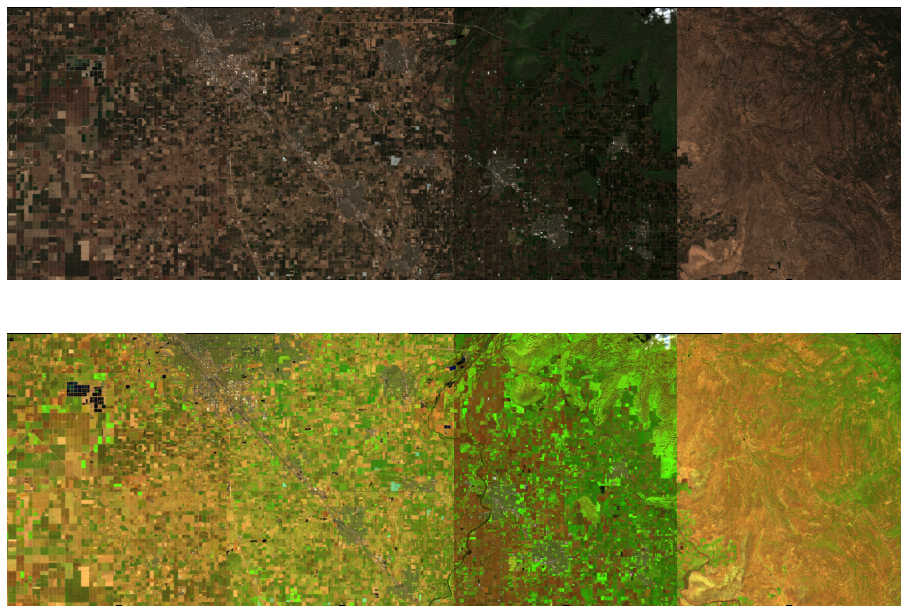

In [ ]:
base_paths = ['S2SR_11_2019_36.625_-119.875',
              'S2SR_10_2019_36.625_-119.625',
              'S2SR_2_2019_36.625_-119.375',
              'S2SR_8_2019_36.625_-119.125']
plot_band_combs(base_paths, band_combinations)

##Latitude: 36.875

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


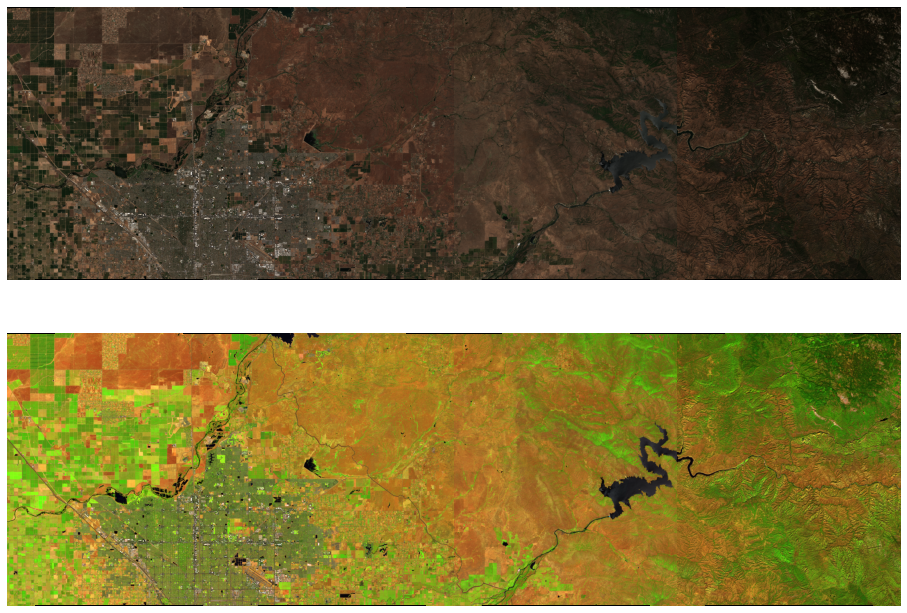

In [ ]:
base_paths = ['S2SR_7_2019_36.875_-119.875',
              'S2SR_5_2019_36.875_-119.625',
              'S2SR_6_2019_36.875_-119.375',
              'S2SR_10_2019_36.875_-119.125']
plot_band_combs(base_paths, band_combinations)

##Latitude: 38.375

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


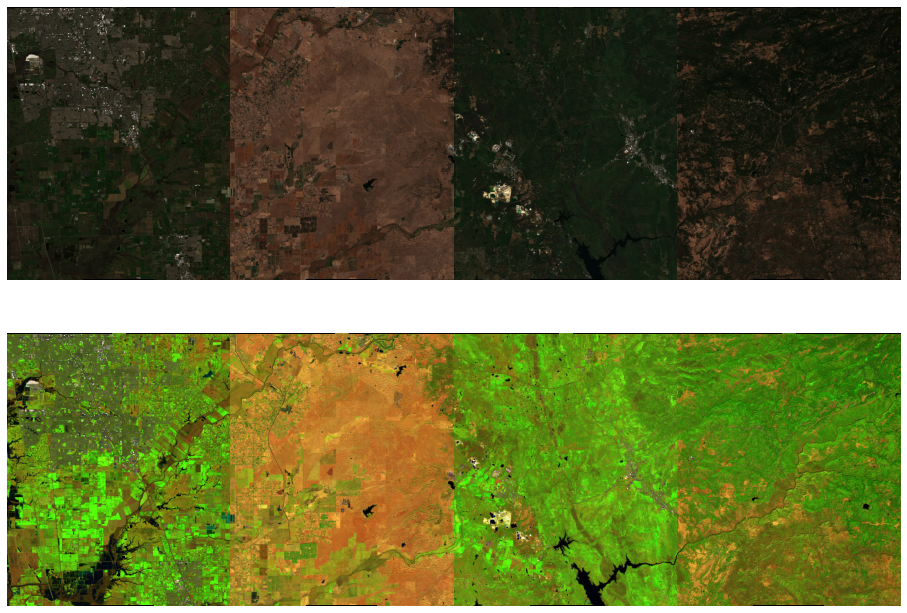

In [16]:
base_paths = ['S2SR_2_2019_38.375_-121.375',
              'S2SR_11_2019_38.375_-121.125',
              'S2SR_4_2019_38.375_-120.875',
              'S2SR_9_2019_38.375_-120.625']
plot_band_combs(base_paths, band_combinations)

##Latitude: 38.625

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


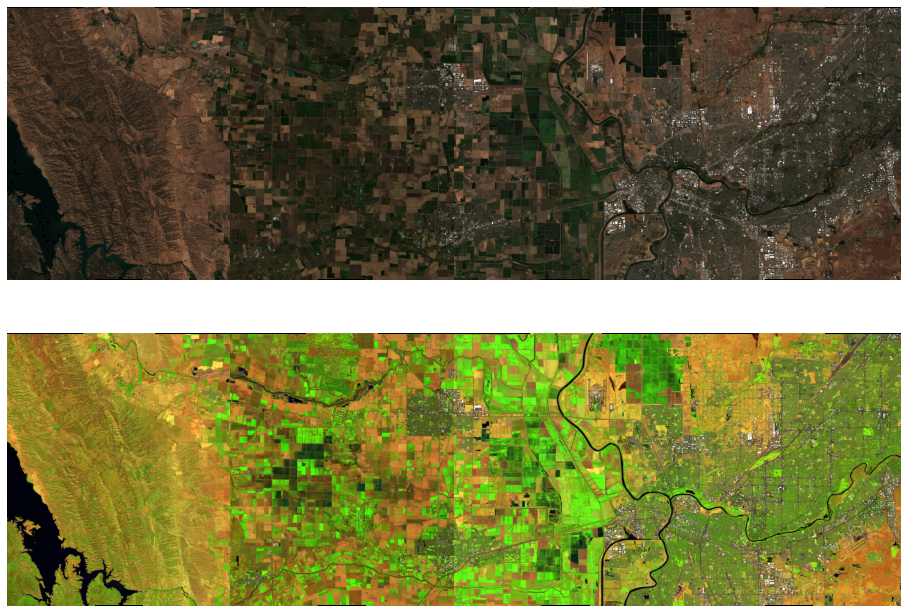

In [18]:
base_paths = ['S2SR_8_2019_38.625_-122.125',
              'S2SR_2_2019_38.625_-121.875',
              'S2SR_7_2019_38.625_-121.625',
              'S2SR_7_2019_38.625_-121.375']
plot_band_combs(base_paths, band_combinations)

##Latitude: 38.875

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


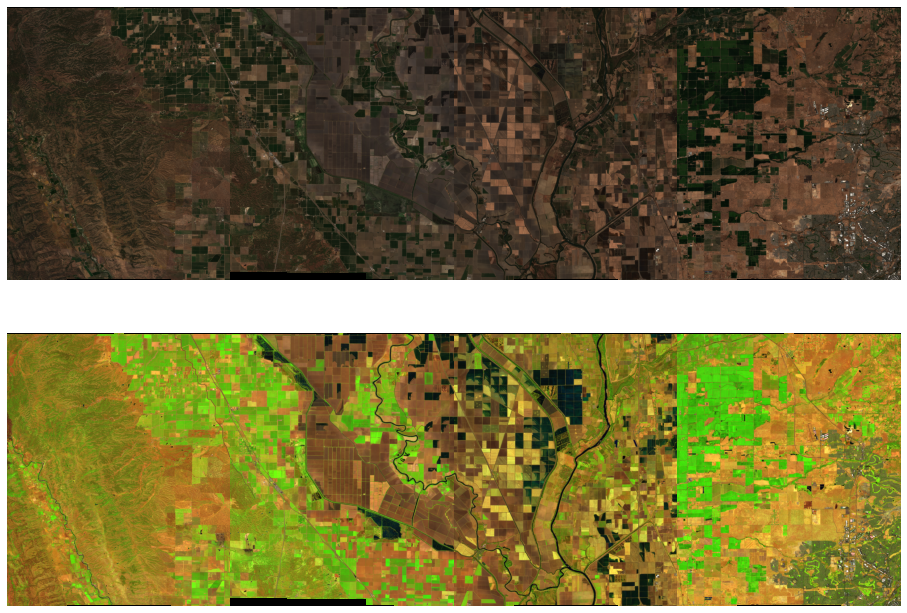

In [13]:
base_paths = ['S2SR_6_2019_38.875_-122.125',
              'S2SR_5_2019_38.875_-121.875',
              'S2SR_11_2019_38.875_-121.625',
              'S2SR_8_2019_38.875_-121.375']
plot_band_combs(base_paths, band_combinations)

## Latitude: 39.125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


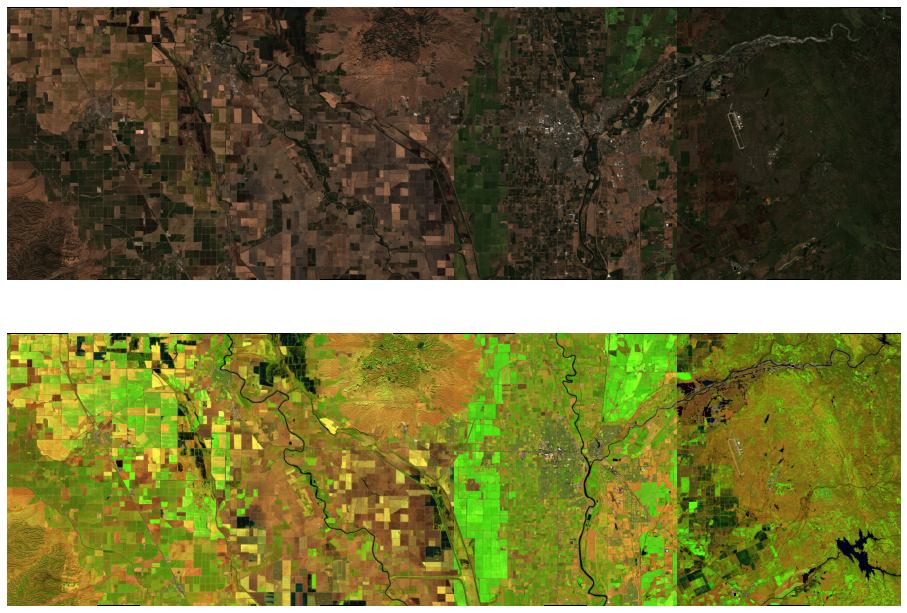

In [7]:
base_paths = ['S2SR_10_2019_39.125_-122.125',
              'S2SR_11_2019_39.125_-121.875',
              'S2SR_9_2019_39.125_-121.625',
              'S2SR_3_2019_39.125_-121.375']
plot_band_combs(base_paths, band_combinations)

## Latitude: 39.375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


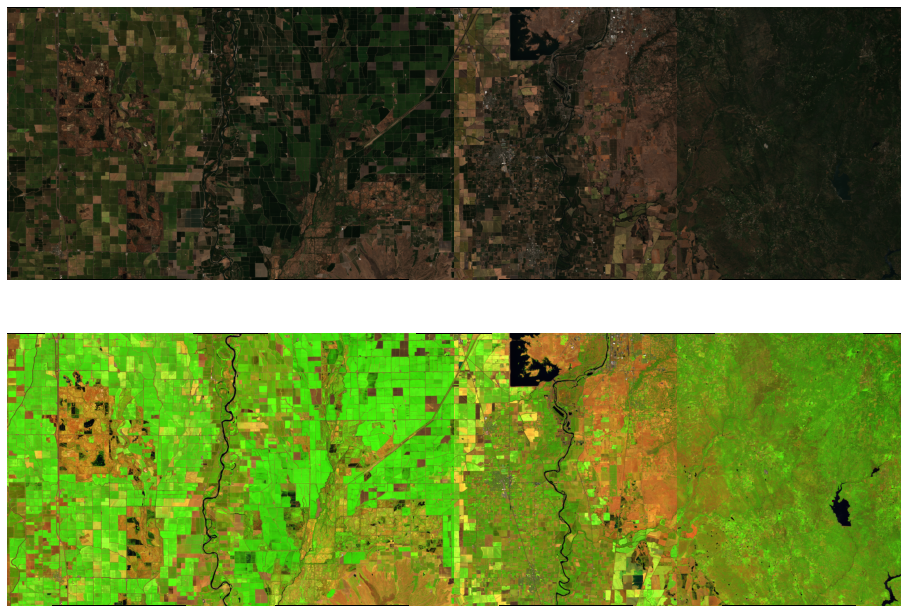

In [8]:
base_paths = ['S2SR_9_2019_39.375_-122.125',
              'S2SR_8_2019_39.375_-121.875',
              'S2SR_10_2019_39.375_-121.625',
              'S2SR_5_2019_39.375_-121.375']
plot_band_combs(base_paths, band_combinations)

## Latitude: 39.625

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


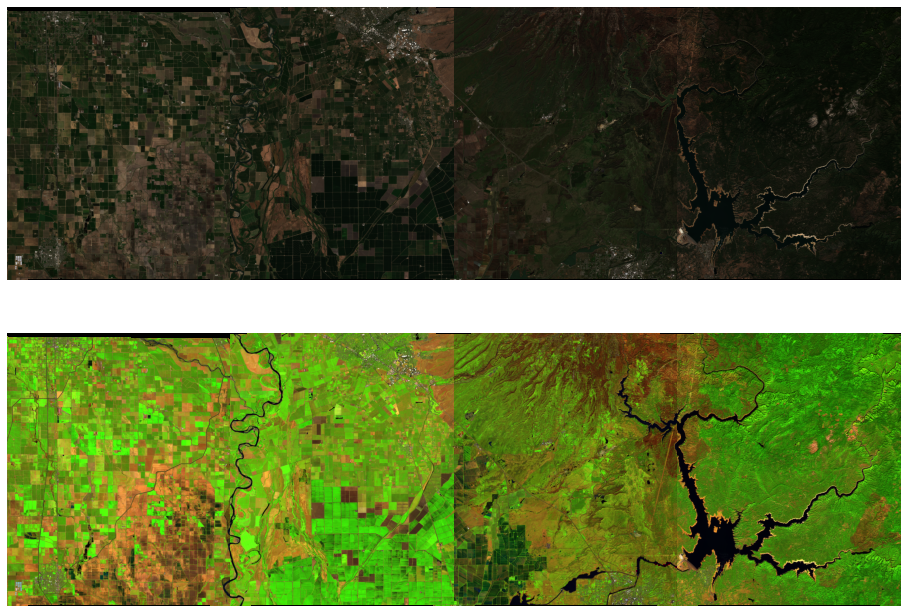

In [9]:
base_paths = ['S2SR_3_2019_39.625_-122.125',
              'S2SR_7_2019_39.625_-121.875',
              'S2SR_3_2019_39.625_-121.625',
              'S2SR_10_2019_39.625_-121.375']
plot_band_combs(base_paths, band_combinations)

##Latitude: 39.875

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


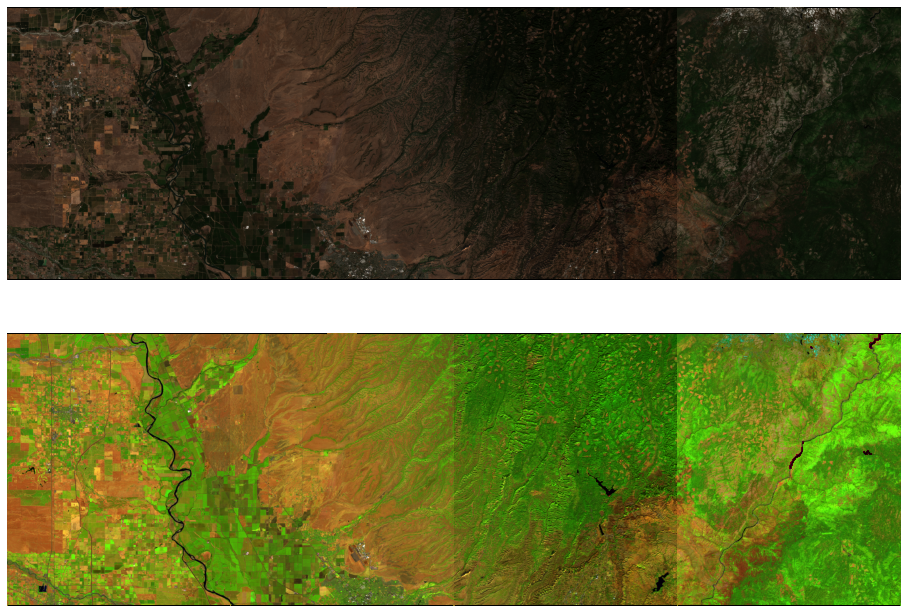

In [10]:
base_paths = ['S2SR_10_2019_39.875_-122.125',
              'S2SR_9_2019_39.875_-121.875',
              'S2SR_11_2019_39.875_-121.625',
              'S2SR_6_2019_39.875_-121.375']
plot_band_combs(base_paths, band_combinations)

In [ ]:
def plot_grid(base_paths, comb, scale = SCALE_FACTOR):
    imarrays = []
    nrows, ncols = np.shape(base_paths)
    
    for row in base_paths:
        for base_path in row:
          if base_path:
            for b, band_name in enumerate(comb):
                # First finds related GeoTIFF path and reads values as an array
                band_path = os.path.join(sr_path, base_path, f'{base_path}_msi_{band_name}.tif')
                band_ds = gdal.Open(band_path,  gdal.GA_ReadOnly)
                raster_band = band_ds.GetRasterBand(1)
                band_data = raster_band.ReadAsArray()
                if b == 0:
                    imarray = np.zeros((1135, 928,3))
                if band_data.shape != imarray.shape[:2]:
                    band_data = cv2.resize(band_data, (imarray.shape[1],imarray.shape[0]))
                imarray[:,:,b] = band_data / scale
            imarrays.append(imarray)
          else:
            imarray = np.zeros((1135, 928,3))
            imarrays.append(imarray)

    fix, axes = plt.subplots(ncols=ncols,
                             nrows=nrows,
                             sharex=True,
                             sharey=True,
                             figsize=(4*ncols,5.02*nrows))
    axes = axes.flatten()
    for i, img in enumerate(imarrays):
        axes[i].imshow(img)
    for ax in axes:
        ax.set_axis_off()
        
    plt.subplots_adjust(hspace=0.0,wspace=0.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

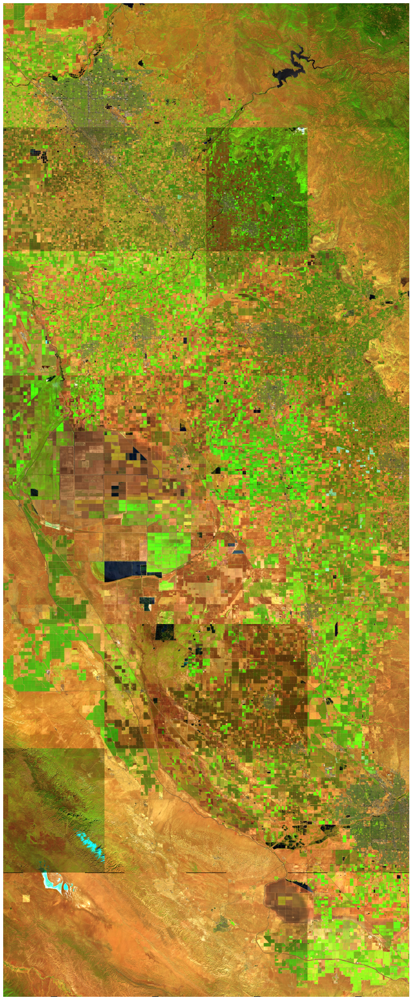

In [ ]:
grid_paths = [['S2SR_7_2019_36.875_-119.875',
              'S2SR_5_2019_36.875_-119.625',
              'S2SR_6_2019_36.875_-119.375',
              'S2SR_10_2019_36.875_-119.125'],
             ['S2SR_11_2019_36.625_-119.875',
              'S2SR_10_2019_36.625_-119.625',
              'S2SR_2_2019_36.625_-119.375',
              'S2SR_8_2019_36.625_-119.125'],
            ['S2SR_6_2019_36.375_-119.875',
              'S2SR_6_2019_36.375_-119.625',
              'S2SR_10_2019_36.375_-119.375',
              'S2SR_10_2019_36.375_-119.125'],
            ['S2SR_3_2019_36.125_-119.875',
              'S2SR_11_2019_36.125_-119.625',
              'S2SR_4_2019_36.125_-119.375',
              'S2SR_9_2019_36.125_-119.125'],
            ['S2SR_11_2019_35.875_-119.875',
              'S2SR_6_2019_35.875_-119.625',
              'S2SR_6_2019_35.875_-119.375',
              'S2SR_8_2019_35.875_-119.125'],
            ['S2SR_5_2019_35.625_-119.875',
              'S2SR_1_2019_35.625_-119.625',
              'S2SR_1_2019_35.625_-119.375',
              'S2SR_7_2019_35.625_-119.125'],
            ['S2SR_12_2019_35.375_-119.875',
              'S2SR_11_2019_35.375_-119.625',
              'S2SR_11_2019_35.375_-119.375',
              'S2SR_11_2019_35.375_-119.125'],
            ['S2SR_8_2019_35.125_-119.875',
              'S2SR_9_2019_35.125_-119.625',
              'S2SR_10_2019_35.125_-119.375',
              'S2SR_6_2019_35.125_-119.125']        
             ]
plot_grid(grid_paths, ag_names)

In [ ]:
def plot_grid_index(base_paths, index, scale = SCALE_FACTOR):
    imarrays = []
    nrows, ncols = np.shape(base_paths)
    
    assert(index in 'VI MI'.split())
    if index =='VI':
        b1 = 'B8'
        b2 = 'B4'
        color_map = 'RdYlGn'
    else:
        b1, b2 = 'B8A', 'B11'
        color_map = 'hsv'
    
    for row in base_paths:
        for base_path in row:
            # First finds related GeoTIFF path and reads values as an array
            band_path = os.path.join(sr_path, base_path, f'{base_path}_msi_{b1}.tif')
            band_ds = gdal.Open(band_path,  gdal.GA_ReadOnly)
            raster_band = band_ds.GetRasterBand(1)
            b1_data = raster_band.ReadAsArray()

            band_path = os.path.join(sr_path, base_path, f'{base_path}_msi_{b2}.tif')
            band_ds = gdal.Open(band_path,  gdal.GA_ReadOnly)
            raster_band = band_ds.GetRasterBand(1)
            b2_data = raster_band.ReadAsArray()
            
            imarray = (b1_data-b2_data) / (b1_data + b2_data)
            imarrays.append(imarray)

    fix, axes = plt.subplots(ncols=ncols,
                             nrows=nrows,
                             sharex=True,
                             sharey=True,
                             figsize=(4*ncols,5.02*nrows))
    axes = axes.flatten()
    for i, img in enumerate(imarrays):
        axes[i].imshow(img, cmap=color_map)
    for ax in axes:
        ax.set_axis_off()
        
    plt.subplots_adjust(hspace=0.0,wspace=0.0)

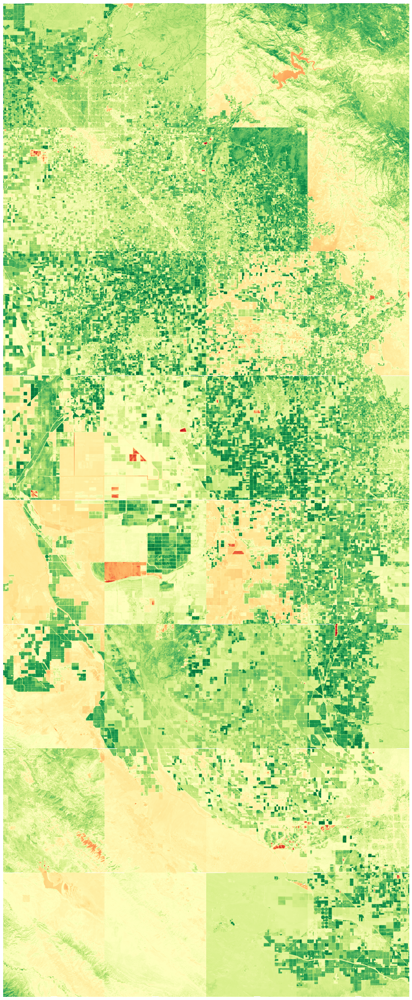

In [ ]:
plot_grid_index(grid_paths, 'VI')

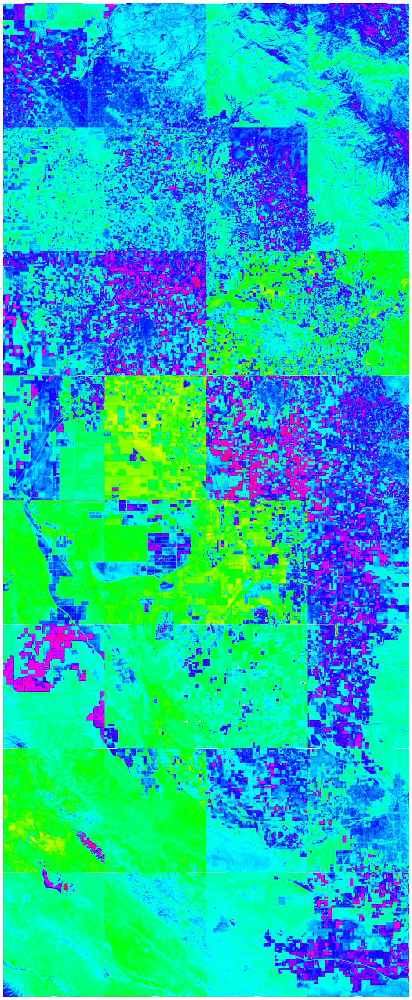

In [ ]:
plot_grid_index(grid_paths, 'MI')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

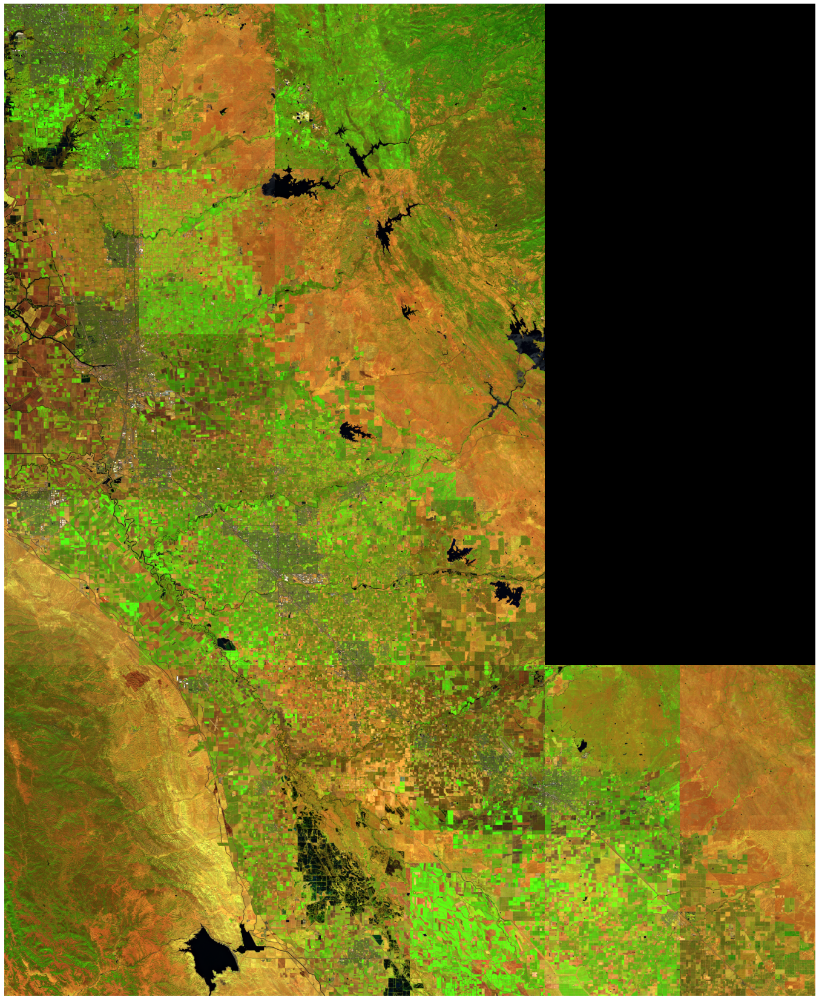

In [ ]:
grid_paths = [['S2SR_2_2019_38.375_-121.375',
              'S2SR_11_2019_38.375_-121.125',
              'S2SR_4_2019_38.375_-120.875',
              'S2SR_9_2019_38.375_-120.625', None, None],
            ['S2SR_11_2019_38.125_-121.375',
              'S2SR_6_2019_38.125_-121.125',
              'S2SR_10_2019_38.125_-120.875',
              'S2SR_10_2019_38.125_-120.625', None, None],
              [ 'S2SR_11_2019_37.875_-121.375',
              'S2SR_10_2019_37.875_-121.125',
              'S2SR_9_2019_37.875_-120.875',
              'S2SR_7_2019_37.875_-120.625', None, None],
              ['S2SR_8_2019_37.625_-121.375',
              'S2SR_4_2019_37.625_-121.125',
              'S2SR_9_2019_37.625_-120.875',
              'S2SR_11_2019_37.625_-120.625', None, None],
              ['S2SR_10_2019_37.375_-121.375',
              'S2SR_10_2019_37.375_-121.125',
              'S2SR_11_2019_37.375_-120.875',
              'S2SR_1_2019_37.375_-120.625',
              'S2SR_4_2019_37.375_-120.375',
              'S2SR_6_2019_37.375_-120.125'],
              ['S2SR_10_2019_37.125_-121.375',
              'S2SR_10_2019_37.125_-121.125',
              'S2SR_10_2019_37.125_-120.875',
              'S2SR_8_2019_37.125_-120.625',
              'S2SR_5_2019_37.125_-120.375',
              'S2SR_11_2019_37.125_-120.125']
             ]
plot_grid(grid_paths, ag_names)